## 1.Imports of libraries


In [3]:
#libraries for data handling and analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_ta as ta
from scipy.stats import linregress
import plotly.graph_objects as go

#Machine learning imports
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

## 2.Load dataset

In [4]:
#Load data from CSV file, Source: https://www.dukascopy.com/swiss/english/marketwatch/historical/
df = pd.read_csv("BTCUSD_m5.csv")

# Display rows of the dataframe
df.tail(10)



,Local time,Open,High,Low,Close
109721,01.05.2024 23:10:00.000 GMT+0100,57956,58009,57755,57855
109722,01.05.2024 23:15:00.000 GMT+0100,57856,57856,57795,57818
109723,01.05.2024 23:20:00.000 GMT+0100,57818,57834,57763,57808
109724,01.05.2024 23:25:00.000 GMT+0100,57808,57948,57798,57894
109725,01.05.2024 23:30:00.000 GMT+0100,57894,57966,57841,57873
109726,01.05.2024 23:35:00.000 GMT+0100,57872,58021,57851,57916
109727,01.05.2024 23:40:00.000 GMT+0100,57915,58027,57861,57964
109728,01.05.2024 23:45:00.000 GMT+0100,57966,58033,57860,57904
109729,01.05.2024 23:50:00.000 GMT+0100,57903,58040,57859,57925
109730,01.05.2024 23:55:00.000 GMT+0100,57884,57936,57734,57761


In [5]:
df.isnull().sum()

Local time    0
Open          0
High          0
Low           0
Close         0
dtype: int64

## 3.Features Engineering

In [6]:
#df.ta.indicatords()
#help(ta.atr)

In [7]:
#Calculate technical indicators using the talib library 

df['ATR'] = df.ta.atr(length=20)
df['RSI'] = df.ta.rsi()
df['Average'] = ta.midprice(df['High'], df['Low'])
df['MA40'] = df.ta.sma(length=40)
df['MA80'] = df.ta.sma(length=80)
df['MA160'] = df.ta.sma(length=160)

#Clean rows with NaN values
df.dropna(inplace=True)


#Calculate the slope of MA for the trend analysis

In [8]:
# Define function to calculate the slope of a given numeric series useful for trend analysis

#https://saturncloud.io/blog/calculating-slopes-in-numpy-or-scipy/
def get_slope(array):
    y = np.array(array)
    x = np.arange(len(y))
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    return slope

#Define how many candle to look back
roll_back = 6

# Calculate the slopes of moving averages and other indicators
df['RSISlope'] = df['RSI'].rolling(window=roll_back).apply(get_slope, raw=True)
df['slopeMA40'] = df['MA40'].rolling(window=roll_back).apply(get_slope, raw=True)
df['slopeMA80'] = df['MA80'].rolling(window=roll_back).apply(get_slope, raw=True)
df['slopeMA160'] = df['MA160'].rolling(window=roll_back).apply(get_slope, raw=True)
df['AverageSlope'] = df['Average'].rolling(window=roll_back).apply(get_slope, raw=True)


In [9]:
#Clean rows after calculating the slopes
df.dropna(inplace=True)

#Display dataframe
df

,Local time,Open,High,Low,Close,ATR,RSI,Average,MA40,MA80,MA160,RSISlope,slopeMA40,slopeMA80,slopeMA160,AverageSlope
164,01.01.2023 13:40:00.000 GMT-0000,16530,16530,16530,16530,0.000000,0.000000,16530.0,16530.000,16530.0000,16530.00000,0.000000,0.000000,0.000000,0.000000,0.000000
165,01.01.2023 13:45:00.000 GMT-0000,16530,16530,16530,16530,0.000000,0.000000,16530.0,16530.000,16530.0000,16530.00000,0.000000,0.000000,0.000000,0.000000,0.000000
166,01.01.2023 13:50:00.000 GMT-0000,16530,16530,16530,16530,0.000000,0.000000,16530.0,16530.000,16530.0000,16530.00000,0.000000,0.000000,0.000000,0.000000,0.000000
167,01.01.2023 13:55:00.000 GMT-0000,16530,16530,16530,16530,0.000000,0.000000,16530.0,16530.000,16530.0000,16530.00000,0.000000,0.000000,0.000000,0.000000,0.000000
168,01.01.2023 14:00:00.000 GMT-0000,16474,16479,16473,16478,2.850000,0.000000,16501.5,16528.700,16529.3500,16529.67500,0.000000,-0.185714,-0.092857,-0.046429,-4.071429
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109726,01.05.2024 23:35:00.000 GMT+0100,57872,58021,57851,57916,239.926012,57.000130,57931.0,57551.925,57568.2125,57502.19375,0.448062,-20.115000,12.155357,3.795357,5.600000
109727,01.05.2024 23:40:00.000 GMT+0100,57915,58027,57861,57964,236.229712,58.633892,57939.0,57544.100,57581.5250,57506.13125,0.921430,-16.335714,12.635000,3.871786,19.314286
109728,01.05.2024 23:45:00.000 GMT+0100,57966,58033,57860,57904,233.068226,55.780892,57946.5,57541.925,57595.3500,57510.00000,0.536799,-11.905000,13.103571,4.006250,28.128571
109729,01.05.2024 23:50:00.000 GMT+0100,57903,58040,57859,57925,230.464815,56.577276,57949.5,57560.725,57607.1250,57513.82500,0.091501,-4.958571,13.153214,4.136607,19.185714


C:\Users\Hamza\AppData\Local\Temp\ipykernel_19208\2334742471.py:6: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared.
  df_model.hist(ax=ax)


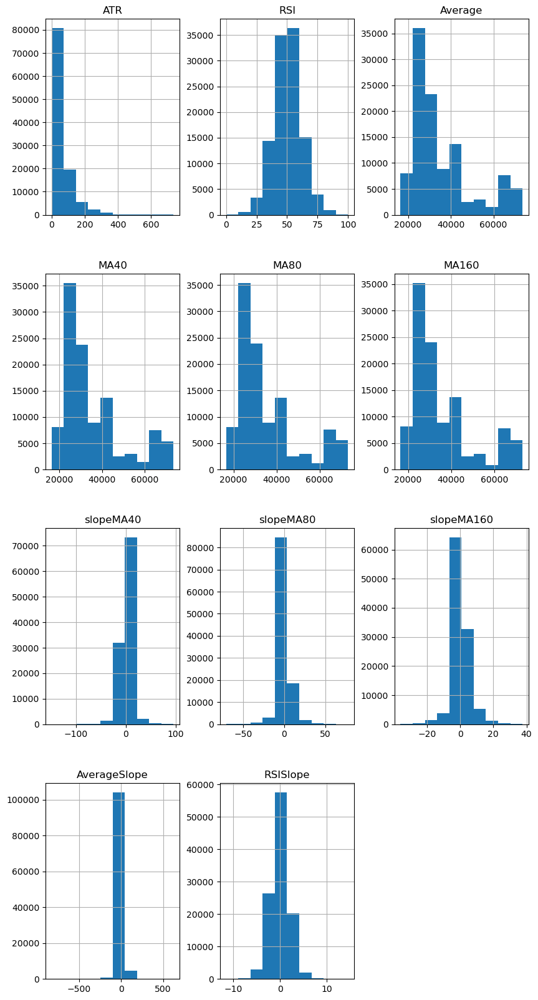

In [10]:
# Plot histograms of the indicators to see distribution

fig = plt.figure(figsize=(10,20))
ax = fig.gca()
df_model = df[['ATR', 'RSI', 'Average', 'MA40', 'MA80', 'MA160', 'slopeMA40', 'slopeMA80', 'slopeMA160', 'AverageSlope', 'RSISlope']]
df_model.hist(ax=ax)
plt.show()

In [11]:
#Function to for detecting price trend based on ma movements
#This will be our Y(Target)

def check_candles(data, backcandles, ma_column):
    categories = [0] * backcandles
    for i in range(backcandles, len(data)):
        close_prices = data['Close'].iloc[i-backcandles:i]
        ma_values = data[ma_column].iloc[i-backcandles:i]
        if all(close_prices > ma_values):
            categories.append(2)  # Uptrend
        elif all(close_prices < ma_values):
            categories.append(1)  # Downtrend
        else:
            categories.append(0)  # No trend
    return categories

df['Category'] = check_candles(df, 6, 'MA40')
df.tail(10)

,Local time,Open,High,Low,Close,ATR,RSI,Average,MA40,MA80,MA160,RSISlope,slopeMA40,slopeMA80,slopeMA160,AverageSlope,Category
109721,01.05.2024 23:10:00.000 GMT+0100,57956,58009,57755,57855,275.519629,55.327054,57901.0,57651.675,57507.2625,57482.38125,0.328070,-18.105000,12.085714,6.505893,28.342857,2
109722,01.05.2024 23:15:00.000 GMT+0100,57856,57856,57795,57818,264.793648,54.019722,57882.0,57625.750,57518.5500,57486.69375,-0.717283,-22.436429,11.710714,6.373214,13.628571,2
109723,01.05.2024 23:20:00.000 GMT+0100,57818,57834,57763,57808,255.103966,53.650739,57809.5,57600.950,57529.9875,57490.60000,-1.312095,-25.691429,11.162857,5.827679,-6.357143,2
109724,01.05.2024 23:25:00.000 GMT+0100,57808,57948,57798,57894,249.848767,56.408397,57855.5,57580.550,57542.0750,57493.45625,-1.219226,-26.552143,11.155000,4.818393,-19.342857,2
109725,01.05.2024 23:30:00.000 GMT+0100,57894,57966,57841,57873,243.606329,55.539427,57882.0,57564.125,57554.7500,57497.00000,-0.431384,-24.858571,11.476786,3.967143,-11.471429,2
109726,01.05.2024 23:35:00.000 GMT+0100,57872,58021,57851,57916,239.926012,57.000130,57931.0,57551.925,57568.2125,57502.19375,0.448062,-20.115000,12.155357,3.795357,5.600000,2
109727,01.05.2024 23:40:00.000 GMT+0100,57915,58027,57861,57964,236.229712,58.633892,57939.0,57544.100,57581.5250,57506.13125,0.921430,-16.335714,12.635000,3.871786,19.314286,2
109728,01.05.2024 23:45:00.000 GMT+0100,57966,58033,57860,57904,233.068226,55.780892,57946.5,57541.925,57595.3500,57510.00000,0.536799,-11.905000,13.103571,4.006250,28.128571,2
109729,01.05.2024 23:50:00.000 GMT+0100,57903,58040,57859,57925,230.464815,56.577276,57949.5,57560.725,57607.1250,57513.82500,0.091501,-4.958571,13.153214,4.136607,19.185714,2
109730,01.05.2024 23:55:00.000 GMT+0100,57884,57936,57734,57761,229.041574,49.134891,57887.0,57574.200,57615.0375,57516.86875,-1.032693,2.131429,12.342857,3.945893,2.514286,2


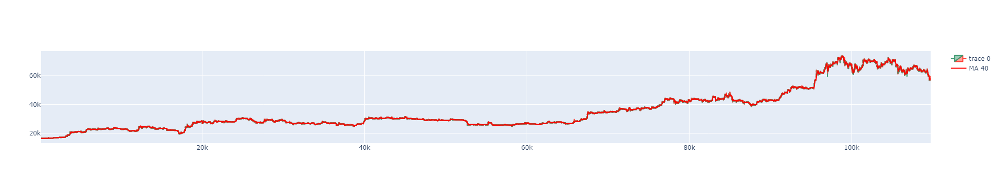

In [12]:
# Plot a candlestick chart with price and MA40 for better understanding
dfpl = df[:]
fig = go.Figure(data=[go.Candlestick(x=dfpl.index,
                open=dfpl['Open'],
                high=dfpl['High'],
                low=dfpl['Low'],
                close=dfpl['Close'])])
fig.add_trace(go.Scatter(x=dfpl.index, y=dfpl['MA40'], mode='lines', name='MA 40', line=dict(color='red')))
fig.update_layout(xaxis_rangeslider_visible=False)
fig.show()

In [13]:
#Check if the categories are balanced
df['Category'].value_counts()

Category
2    39976
1    37224
0    32367
Name: count, dtype: int64

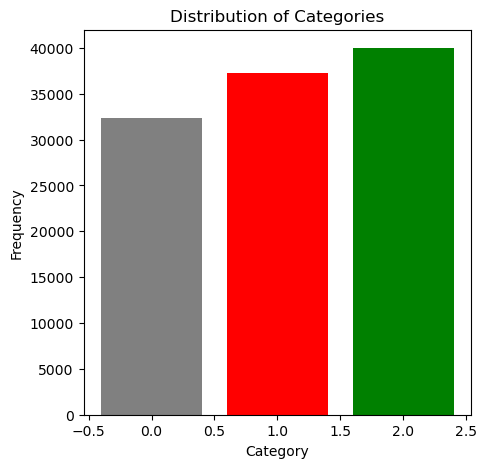

In [16]:


# Count occurrences of each category and sort by index
class_counts = df['Category'].value_counts().sort_index()

# Plot a bar chart
plt.figure(figsize=(5, 5))
plt.bar(class_counts.index, class_counts.values, color=['grey', 'red', 'green'])
plt.xlabel('Category')
plt.ylabel('Frequency')
plt.title('Distribution of Categories')
plt.show()



## 4.Define the features and target variables that will be fed into the model.



In [17]:
# Split data into features and target
X = df[['Open', 'High', 'Low', 'Close', 'ATR', 'RSI', 'Average', 'MA40', 'MA80', 'MA160', 'slopeMA40', 'slopeMA80', 'slopeMA160', 'AverageSlope', 'RSISlope']]
y = df['Category']

## 5.Split data into Training, Validation and Testing 

In [18]:
# Define data into training, validation, and testing
#Time-series data split 
train_end = int(len(df) * 0.70)
val_end = int(len(df) * 0.85)

# Split the data by indices
X_train, y_train = X[:train_end], y[:train_end]
X_val, y_val = X[train_end:val_end], y[train_end:val_end]
X_test, y_test = X[val_end:], y[val_end:]

## 6.Scale the features using the Standard Scaler

In [19]:
#Initialize and fit the scaler on the training data
scaler = StandardScaler()
scaler.fit(X_train)

# Transform the training, validation, and test datasets
X_train_scaled = scaler.transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

print(X_train_scaled)
print(X_val_scaled)
print(X_test_scaled)
print('*****Shape 2D*****')

print(X_train_scaled.shape)
print(X_val_scaled.shape)
print(X_test_scaled.shape)



[[-2.37306044e+00 -2.37558147e+00 -2.37048191e+00 ... -1.00591921e-01
  -1.79979701e-02 -2.35876718e-04]
 [-2.37306044e+00 -2.37558147e+00 -2.37048191e+00 ... -1.00591921e-01
  -1.79979701e-02 -2.35876718e-04]
 [-2.37306044e+00 -2.37558147e+00 -2.37048191e+00 ... -1.00591921e-01
  -1.79979701e-02 -2.35876718e-04]
 ...
 [ 3.04032042e+00  3.03729208e+00  3.03869057e+00 ... -7.96162681e-01
  -4.36420605e-01  1.05763550e+00]
 [ 3.03880248e+00  3.03685867e+00  3.04042657e+00 ... -7.81284162e-01
  -9.15580930e-02  1.54053920e+00]
 [ 3.03836879e+00  3.04444336e+00  3.04042657e+00 ... -7.28717042e-01
   5.35680374e-01  2.10130592e+00]]
[[ 3.04986171  3.05571206  3.05583361 ... -0.68326098  1.09726841
   2.21552205]
 [ 3.0589693   3.05376171  3.05865461 ... -0.63725791  1.33614107
   1.44775657]
 [ 3.05918615  3.05462853  3.05735261 ... -0.56242771  1.32190362
   1.30305978]
 ...
 [ 5.19036333  5.18376147  5.19415693 ... -1.10636886  0.78879047
   0.88372308]
 [ 5.18992963  5.20456521  5.196977

## 7.Train the Model and Evaluate


In [20]:
# Train a RandomForest classifier
model = RandomForestClassifier(random_state=None)
model.fit(X_train_scaled, y_train)

# Predict on validation set and evaluate the accuracy
y_val_pred = model.predict(X_val_scaled)
print("Validation Accuracy:", accuracy_score(y_val, y_val_pred))
print(classification_report(y_val, y_val_pred))

# Predict on test set and evaluate the accuracy
y_test_pred = model.predict(X_test_scaled)
print("Test Accuracy:", accuracy_score(y_test, y_test_pred))
print(classification_report(y_test, y_test_pred))

Validation Accuracy: 0.7527228475813812
              precision    recall  f1-score   support

           0       0.56      0.72      0.63      4713
           1       0.84      0.82      0.83      5425
           2       0.89      0.72      0.80      6297

    accuracy                           0.75     16435
   macro avg       0.76      0.75      0.75     16435
weighted avg       0.78      0.75      0.76     16435

Test Accuracy: 0.7153808712582137
              precision    recall  f1-score   support

           0       0.51      0.74      0.60      4744
           1       0.86      0.79      0.82      5577
           2       0.87      0.63      0.73      6115

    accuracy                           0.72     16436
   macro avg       0.75      0.72      0.72     16436
weighted avg       0.76      0.72      0.72     16436



## 8.Confusion Matrix 

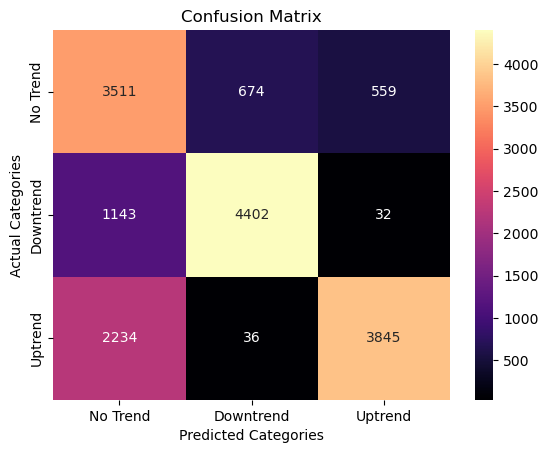

In [21]:
# Calculate and plot the confusion matrix
cm = confusion_matrix(y_test, y_test_pred)
sns.heatmap(cm, annot=True, fmt="d", cmap="magma", xticklabels=['No Trend', 'Downtrend', 'Uptrend'], yticklabels=['No Trend', 'Downtrend', 'Uptrend'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Categories')
plt.ylabel('Actual Categories')
plt.show()
